In [1]:
import os
import sys
sys.path.append('..')
import torch

import pretorched.visualizers as vutils
from pretorched.models import utils as mutils
import core
from data import VideoFolder

%load_ext autoreload
%autoreload 2

In [2]:
device = 'cpu' if torch.cuda.is_available() else 'cpu'

In [3]:
data_root = os.environ.get('DATA_ROOT', '')
part_dir = os.path.join(data_root, 'DeepfakeDetection', 'facenet_videos', 'dfdc_train_part_0')
videos = os.listdir(part_dir)

In [4]:
datadir = os.path.join(part_dir, videos[1])
dataset = VideoFolder(datadir, step=6)
print(dataset)

Dataset VideoFolder
  Root dir: /data/datasets/DeepfakeDetection/facenet_videos/dfdc_train_part_0/bqefygjsnx.mp4
  Number of datapoints: 2
  Transforms (if any): VideoToTensor(rescale=False, ordering='CTHW')



In [5]:
model = core.get_model('SeriesPretrainedManipulatorDetector')
model = model.to(device)

In [6]:
name, frames, target = dataset[0]
frames = frames.unsqueeze(0)
print(frames.shape, frames.min(), frames.mean(), frames.max())

torch.Size([1, 3, 50, 360, 360]) tensor(0.) tensor(91.5118) tensor(255.)


## Original Frames

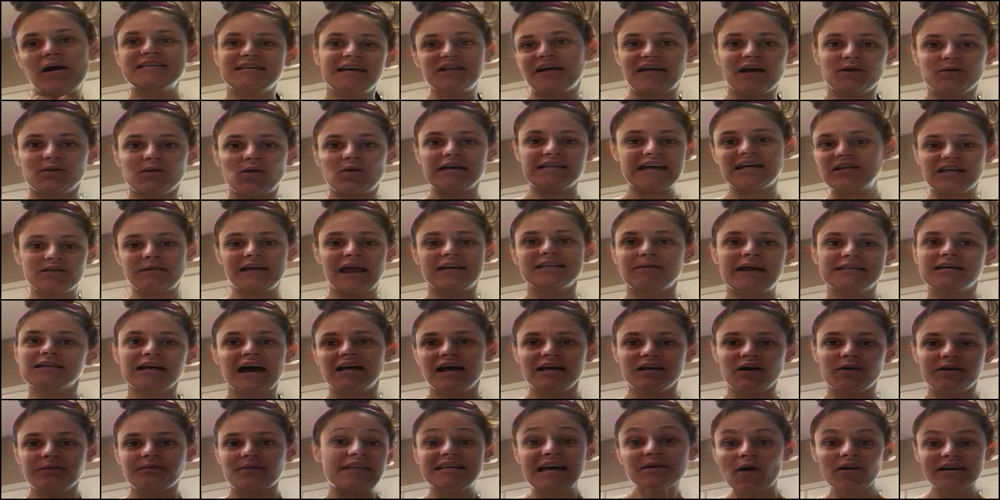

In [7]:
vutils.visualize_samples(frames.squeeze(0).transpose(0, 1), nrow=10)

In [8]:
with torch.no_grad():
    frames = frames.to(device)
    out = model.manipulator_model.manipulate_video(frames, amp=4)

## Full MagNet Magnification with amp = 4

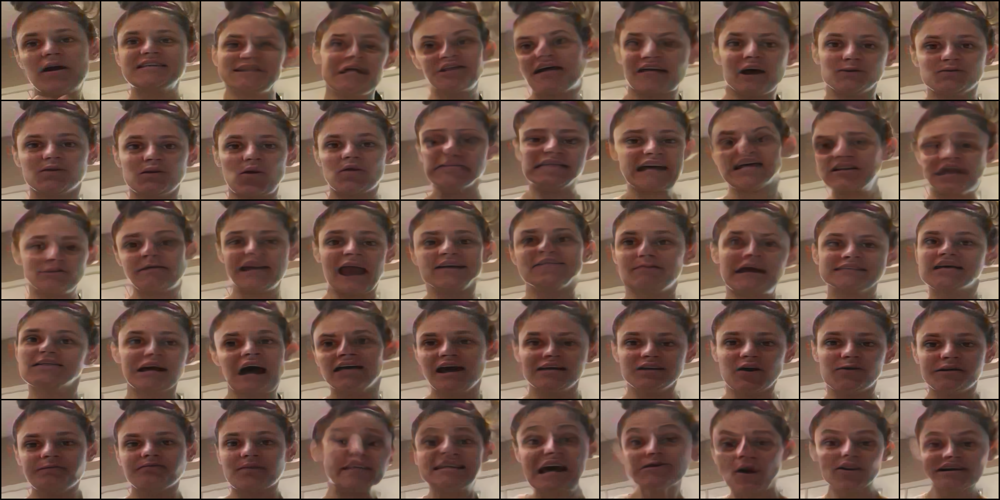

In [9]:
vutils.visualize_samples(out.squeeze(0).transpose(0, 1), nrow=10)

## Medium MagNet (num_resblk_decode = 6 ) Magnification with amp = 4

In [10]:
model = core.get_model('SeriesPretrainedMediumManipulatorDetector')
model = model.to(device)

In [11]:
with torch.no_grad():
    frames = frames.to(device)
    out = model.manipulator_model.manipulate_video(frames, amp=4)

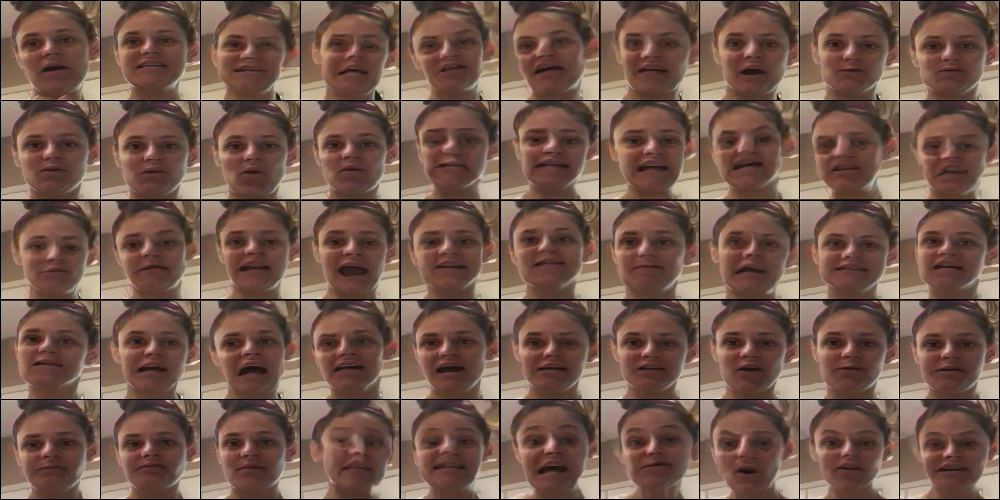

In [12]:
vutils.visualize_samples(out.squeeze(0).transpose(0, 1), nrow=10)

## Small MagNet (num_resblk_decode = 3 ) Magnification with amp = 4

In [13]:
model = core.get_model('SeriesPretrainedSmallManipulatorDetector')
model = model.to(device)

In [14]:
with torch.no_grad():
    frames = frames.to(device)
    out = model.manipulator_model.manipulate_video(frames, amp=4)

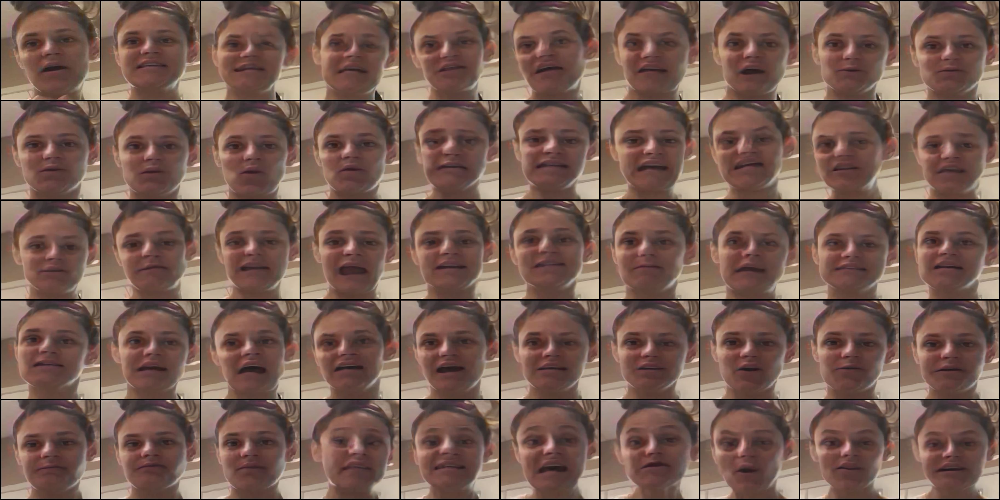

In [15]:
vutils.visualize_samples(out.squeeze(0).transpose(0, 1), nrow=10)